# Import dependencies library

In [5]:
from sagemaker import image_uris, model_uris, script_uris
import sagemaker, boto3, json
from sagemaker import get_execution_role
from sagemaker.estimator import Estimator
from sagemaker.utils import name_from_base
import tarfile
from sagemaker import hyperparameters
from glob import glob
import os
import subprocess

In [6]:
aws_role = get_execution_role()
aws_region = boto3.Session().region_name
sess = sagemaker.Session()

# Get training image_uri

In [7]:
train_model_id, train_model_version, train_scope = "catboost-classification-model", "*", "training"
training_instance_type = "ml.m5.xlarge"

In [8]:
train_model_id, train_model_version, train_scope

('catboost-classification-model', '*', 'training')

In [9]:
train_image_uri = image_uris.retrieve(
    region=None,
    framework=None,
    model_id=train_model_id,
    model_version=train_model_version,
    image_scope=train_scope,
    instance_type=training_instance_type
)

# Retrieve the training script
train_source_uri = script_uris.retrieve(
    model_id=train_model_id, model_version=train_model_version, script_scope=train_scope
)

train_model_uri = model_uris.retrieve(
    model_id=train_model_id, model_version=train_model_version, model_scope=train_scope
)

# Define buckets to hold data & artifacts

In [10]:
training_data_bucket = f"jumpstart-cache-prod-{aws_region}"
training_data_prefix = "training-datasets/tabular_multiclass/"

training_dataset_s3_path = f"s3://{training_data_bucket}/{training_data_prefix}train"
validation_dataset_s3_path = f"s3://{training_data_bucket}/{training_data_prefix}validation"

output_bucket = sess.default_bucket()
output_prefix = "jumpstart-example-tabular-training"

s3_output_location = f"s3://{output_bucket}/cat-boost-test"


# Define hyperparameters and estimator

In [11]:
hyperparameters = hyperparameters.retrieve_default(
    model_id=train_model_id, model_version=train_model_version
)

hyperparameters[
    "iterations"
] = "500"

training_job_name = name_from_base(f"built-in-algo-{train_model_id}-training")

tabular_estimator = Estimator(
    role=aws_role,
    image_uri=train_image_uri,
    source_dir=train_source_uri,
    model_uri=train_model_uri,
    entry_point="transfer_learning.py",
    instance_count=1,
    instance_type=training_instance_type,
    max_run=360000,
    hyperparameters=hyperparameters,
    output_path=s3_output_location
)

# Fit the model

In [12]:
# Launch a SageMaker Training job by passing the S3 path of the training data
tabular_estimator.fit(
    {
        "training": training_dataset_s3_path,
        "validation": validation_dataset_s3_path,
    }, logs=True, job_name=training_job_name
)

INFO:sagemaker:Creating training-job with name: built-in-algo-catboost-classification-m-2023-06-30-17-29-38-053


2023-06-30 17:29:39 Starting - Starting the training job...
2023-06-30 17:29:54 Starting - Preparing the instances for training......
2023-06-30 17:30:45 Downloading - Downloading input data...
2023-06-30 17:31:36 Training - Training image download completed. Training in progress...bash: cannot set terminal process group (-1): Inappropriate ioctl for device
bash: no job control in this shell
2023-06-30 17:31:44,665 sagemaker-training-toolkit INFO     Imported framework sagemaker_pytorch_container.training
2023-06-30 17:31:44,667 sagemaker-training-toolkit INFO     No GPUs detected (normal if no gpus installed)
2023-06-30 17:31:44,676 sagemaker_pytorch_container.training INFO     Block until all host DNS lookups succeed.
2023-06-30 17:31:44,678 sagemaker_pytorch_container.training INFO     Invoking user training script.
2023-06-30 17:31:45,953 sagemaker-training-toolkit INFO     Installing dependencies from requirements.txt:
/opt/conda/bin/python3.8 -m pip install -r requirements.txt
Pr

In [104]:
transformer = tabular_estimator.transformer(
    instance_count=1, instance_type="ml.m5.large", assemble_with="Line", accept="text/csv"
)

INFO:sagemaker:Creating model with name: sagemaker-jumpstart-2023-06-30-05-10-02-031


In [105]:
s3_output_location

's3://sagemaker-ap-southeast-1-405392309789/jumpstart-example-tabular-training/output'

In [106]:
test_data_path = "s3://{}/TestBatch/Iris.csv".format(output_bucket)

In [ ]:
transformer.transform(test_data_path, content_type="text/csv")
print("Waiting for transform job: " + transformer.latest_transform_job.job_name)
transformer.wait()

You will notice that if you try to use estimator that has been crated with training image to deploy, It won't work.

# Load catboost from pre-trained

In [15]:
inference_model_id, inference_model_version, inference_scope = "catboost-classification-model", "*", "inference"

In [16]:
inference_source_uri = script_uris.retrieve(
    model_id=inference_model_id, model_version=inference_model_version, script_scope=inference_scope
)

inference_model_uri = model_uris.retrieve(
    model_id=inference_model_id, model_version=inference_model_version, model_scope=inference_scope
)

# Retreive inference image (Pytorch image)

In [42]:
inference_image_uri = image_uris.retrieve(
    region=None,
    framework=None,
    model_id=inference_model_id,
    model_version=inference_model_version,
    image_scope=inference_scope,
    instance_type='ml.t2.medium'
)

# Create inference estimator

In [43]:
inference_estimator = Estimator(
    role=aws_role,
    image_uri=inference_image_uri,
    #source_dir=inference_source_uri,
    #model_uri=inference_model_uri,
    entry_point="inference.py",
    instance_count=1,
    instance_type='ml.t2.medium',
)

In [165]:
inference_estimator.deploy()

ValueError: Estimator is not associated with a training job

# Define bucket which store our artifacts from training step

In [44]:
bucket = "sagemaker-ap-southeast-1-405392309789"
prefix = "cat-boost-test/built-in-algo-catboost-classification-m-2023-06-30-17-29-38-053/output"
key = "model.tar.gz"

# Get model.tar.gz to add requirements.txt and inference script

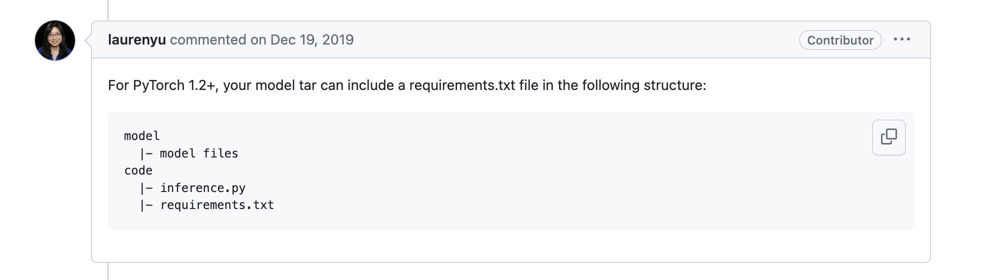

In [58]:
sm_client = boto3.client("sagemaker")
submit_dir = f"s3://{bucket}/{prefix}"
model_artifacts = f"s3://{bucket}/{prefix}/{key}"

In [59]:
s3 = boto3.client('s3')
with open('model.tar.gz', 'wb') as f:
    s3.download_fileobj(bucket, f'{prefix}/{key}', f)

with tarfile.open(key, 'r:gz') as tar:
    tar.extractall('extracted_tar')

with tarfile.open(key, "w:gz") as tar:
    for fn in os.listdir('extracted_tar'):
        p = os.path.join('extracted_tar', fn)
        tar.add(p, arcname=fn)
    tar.add('requirements.txt')
    tar.add('sm-catboost-infer-hack.py')

In [60]:
with open("model.tar.gz", "rb") as f:
    s3.upload_fileobj(f, bucket, f'{prefix}/{key}')

In [61]:
create_model_resp = sm_client.create_model(
    ModelName   = 'test-hack',
    Containers  = [
        {
            "Image"         : inference_image_uri,
            "Mode"          : "SingleModel",
            "ModelDataUrl"  : model_artifacts,
            "Environment"   : {
                'SAGEMAKER_SUBMIT_DIRECTORY': model_artifacts,
                'SAGEMAKER_PROGRAM': 'sm-catboost-infer-hack.py',
            } 
        }
    ],
    ExecutionRoleArn = aws_role,
)

In [62]:
transformer = inference_estimator.transformer(
    model_name='test-hack', strategy='SingleRecord',
    instance_count=1, instance_type="ml.m5.large", assemble_with="Line", 
    accept="text/csv" , output_path=f's3://{bucket}/cat-boost-test'
)

In [63]:
test_data_path = 's3://jumpstart-cache-prod-ap-southeast-1/training-datasets/tabular_multiclass/validation/data.csv'

In [ ]:
transformer.transform(test_data_path, content_type="text/csv", split_type="Line")
print("Waiting for transform job: " + transformer.latest_transform_job.job_name)
transformer.wait()

INFO:sagemaker:Creating transform job with name: pytorch-inference-2023-07-01-11-51-20-782


...........................2023-07-01 11:55:45,638 [INFO ] main org.pytorch.serve.servingsdk.impl.PluginsManager - Initializing plugins manager...
2023-07-01 11:55:45,831 [INFO ] main org.pytorch.serve.ModelServer - 
Torchserve version: 0.4.2
TS Home: /opt/conda/lib/python3.8/site-packages
Current directory: /
Temp directory: /home/model-server/tmp
Number of GPUs: 0
Number of CPUs: 2
Max heap size: 956 M
Python executable: /opt/conda/bin/python3.8
Config file: /etc/sagemaker-ts.properties
Inference address: http://0.0.0.0:8080
Management address: http://0.0.0.0:8080
Metrics address: http://127.0.0.1:8082
Model Store: /.sagemaker/ts/models
Initial Models: model.mar
Log dir: /logs
Metrics dir: /logs
Netty threads: 0
Netty client threads: 0
Default workers per model: 2
Blacklist Regex: N/A
Maximum Response Size: 6553500
Maximum Request Size: 6553500
Prefer direct buffer: false
Allowed Urls: [file://.*|http(s)?://.*]
Custom python dependency for model allowed: false
Metrics report format: 